In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from torch.utils.tensorboard import SummaryWriter
from tqdm import tqdm

# **First GAN introduced in first GAN research paper**

In [ ]:
class Discriminator(nn.Module):
  def __init__(self, img_dim):
    super(Discriminator, self).__init__()
    self.disc = nn.Sequential(
        nn.Linear(img_dim, 128),
        nn.LeakyReLU(0.1),
        nn.Linear(128, 1),
        nn.Sigmoid(),
    )

  def forward(self, x):
    return self.disc(x)

In [ ]:
class Generator(nn.Module):
  def __init__(self,z_dim, img_dim):
    super(Generator, self).__init__()
    self.gen = nn.Sequential(
        nn.Linear(z_dim, 256),
        nn.LeakyReLU(0.1),
        nn.Linear(256, img_dim),
        nn.Tanh(),
    )

  def forward(self, x):
    return self.gen(x)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
lr =0.0003
z_dim =64
image_dim = 28*28*1
batch_size = 32
num_epochs = 50

In [ ]:
disc = Discriminator(image_dim).to(device)
gen = Generator(z_dim, image_dim).to(device)
fixed_noise = torch.randn((batch_size, z_dim)).to(device)

In [ ]:
transforms = transforms.Compose(
    [transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))]
)

In [ ]:
dataset = datasets.MNIST(root="dataset/", transform=transforms, download=True)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 9912422/9912422 [00:02<00:00, 4455869.77it/s]


Extracting dataset/MNIST/raw/train-images-idx3-ubyte.gz to dataset/MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 28881/28881 [00:00<00:00, 130585.37it/s]


Extracting dataset/MNIST/raw/train-labels-idx1-ubyte.gz to dataset/MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 1648877/1648877 [00:02<00:00, 563144.22it/s]


Extracting dataset/MNIST/raw/t10k-images-idx3-ubyte.gz to dataset/MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 4542/4542 [00:00<00:00, 11319387.27it/s]

Extracting dataset/MNIST/raw/t10k-labels-idx1-ubyte.gz to dataset/MNIST/raw



In [ ]:
optim_gen = optim.Adam(gen.parameters(), lr=lr)
optim_disc = optim.Adam(disc.parameters(), lr=lr)
criterion = nn.BCELoss()
writer_fake = SummaryWriter(f"runs/GAN_MNIST/fake")
writer_real = SummaryWriter(f"runs/GAN_MNIST/real")
step = 0

In [ ]:
for epoch in range(num_epochs):
  for batch_idx, (real, _) in enumerate(loader):
    real = real.view(-1, 784).to(device)
    batch_size = real.shape[0]
    # Train Discriminator: max log(D(real)) + log(1 - D(G(z)))
    noise = torch.randn(batch_size, z_dim).to(device)
    fake = gen(noise)
    disc_real = disc(real).view(-1)
    lossD_real = criterion(disc_real, torch.ones_like(disc_real))
    disc_fake = disc(fake).view(-1)
    lossD_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
    lossD = (lossD_real + lossD_fake) / 2
    disc.zero_grad()
    lossD.backward(retain_graph=True)
    optim_disc.step()
    # Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
    output = disc(fake).view(-1)
    lossG = criterion(output, torch.ones_like(output))
    gen.zero_grad()
    lossG.backward()
    optim_gen.step()
    # Print losses occasionally and print to tensorboard
    if batch_idx % 100 == 0:
      print(
          f"Epoch [{epoch}/{num_epochs}]\tBatch {batch_idx}/{len(loader)}\tLoss D: {lossD:.4f}\tLoss G: {lossG:.4f}"
      )
      with torch.no_grad():
        fake = gen(fixed_noise).reshape(-1, 1, 28, 28)
        data = real.reshape(-1, 1, 28, 28)
        img_grid_fake = torchvision.utils.make_grid(fake, normalize=True)
        img_grid_real = torchvision.utils.make_grid(data, normalize=True)
        writer_fake.add_image(
            "Mnist Fake Images", img_grid_fake, global_step=step
        )
        writer_real.add_image(
            "Mnist Real Images", img_grid_real, global_step=step
        )
        step += 1


Streaming output truncated to the last 5000 lines.
Epoch [36/50]	Batch 1250/1875	Loss D: 0.6591	Loss G: 0.9008
Epoch [36/50]	Batch 1255/1875	Loss D: 0.6819	Loss G: 0.9446
Epoch [36/50]	Batch 1260/1875	Loss D: 0.7405	Loss G: 0.6943
Epoch [36/50]	Batch 1265/1875	Loss D: 0.6586	Loss G: 1.0377
Epoch [36/50]	Batch 1270/1875	Loss D: 0.7827	Loss G: 0.7058
Epoch [36/50]	Batch 1275/1875	Loss D: 0.6761	Loss G: 1.0278
Epoch [36/50]	Batch 1280/1875	Loss D: 0.5906	Loss G: 0.9750
Epoch [36/50]	Batch 1285/1875	Loss D: 0.7118	Loss G: 1.0566
Epoch [36/50]	Batch 1290/1875	Loss D: 0.6053	Loss G: 0.9557
Epoch [36/50]	Batch 1295/1875	Loss D: 0.5457	Loss G: 0.9142
Epoch [36/50]	Batch 1300/1875	Loss D: 0.7223	Loss G: 0.9818
Epoch [36/50]	Batch 1305/1875	Loss D: 0.6348	Loss G: 0.9676
Epoch [36/50]	Batch 1310/1875	Loss D: 0.6478	Loss G: 0.9304
Epoch [36/50]	Batch 1315/1875	Loss D: 0.6602	Loss G: 0.7783
Epoch [36/50]	Batch 1320/1875	Loss D: 0.6054	Loss G: 0.9547
Epoch [36/50]	Batch 1325/1875	Loss D: 0.6305	Loss

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=runs/GAN_MNIST

<IPython.core.display.Javascript object>

# **DCGAN Research paper Implementation**

In [ ]:
 class DGDiscriminator(nn.Module):
  def __init__(self, channels_img,features_d):
    super(DGDiscriminator, self).__init__()
    # input: N x channels_img x 64 x64
    self.disc = nn.Sequential(
        nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1
        ), #32x32
        nn.LeakyReLU(0.2),
        self._block(features_d, features_d*2,4,2,1),#16x16
        self._block(features_d*2, features_d*4,4,2,1),#8x8
        self._block(features_d*4, features_d*8,4,2,1),#4x4
        nn.Conv2d(features_d*8, 1, kernel_size=4, stride=2, padding=0),#1x1
        nn.Sigmoid(),
    )
  def _block(self,in_channel,out_channel,kernel_size,stride,padding):
    return nn.Sequential(
        nn.Conv2d(
            in_channel,
            out_channel,
            kernel_size,
            stride,
            padding,
            bias=False
        ),
        nn.BatchNorm2d(out_channel),
        nn.LeakyReLU(0.2)
    )

  def forward(self, x):
    return self.disc(x)


In [ ]:
class DGGenerator(nn.Module):
  def __init__(self, z_dim,channels_img,features_g) -> None:
    super(DGGenerator,self).__init__()
    self.net = nn.Sequential(
        self._block(z_dim,features_g*16,4,1,0),#4x4
        self._block(features_g*16,features_g*8,4,2,1),#8x8
        self._block(features_g*8,features_g*4,4,2,1),#16x16
        self._block(features_g*4,features_g*2,4,2,1),#32x32
        nn.ConvTranspose2d(
            features_g*2,channels_img,kernel_size=4,stride=2,padding=1
        ),
        nn.Tanh(),
    )
  def _block(self,in_channel,out_channel,kernel_size,stride,padding):
    return nn.Sequential(
        nn.ConvTranspose2d(
            in_channel,
            out_channel,
            kernel_size,
            stride,
            padding,
            bias=False
        ),
        nn.BatchNorm2d(out_channel),
        nn.ReLU()
    )
  def forward(self,x):
    return self.net(x)

def init_weight(model):
  for m in model.modules():
    if isinstance(m,(nn.Conv2d,nn.ConvTranspose2d,nn.BatchNorm2d)):
      nn.init.normal_(m.weight.data,0.0,0.02)


In [ ]:
lr = 0.0002
z_dim = 100
batch_size = 128
channels_img = 1
features_d = 64
features_g = 64
image_size = 64
num_epochs = 5

In [ ]:
transforms = transforms.Compose(
    [
        transforms.Resize(image_size),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(channels_img)],[0.5 for _ in range(channels_img)]),
    ]
)

In [ ]:
dataset = datasets.FashionMNIST(root="dataset/", transform=transforms, train=True,download=True)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

100%|██████████| 26421880/26421880 [00:01<00:00, 17543961.38it/s]


Extracting dataset/FashionMNIST/raw/train-images-idx3-ubyte.gz to dataset/FashionMNIST/raw



100%|██████████| 29515/29515 [00:00<00:00, 305631.66it/s]


Extracting dataset/FashionMNIST/raw/train-labels-idx1-ubyte.gz to dataset/FashionMNIST/raw



100%|██████████| 4422102/4422102 [00:00<00:00, 5631960.60it/s]


Extracting dataset/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to dataset/FashionMNIST/raw



100%|██████████| 5148/5148 [00:00<00:00, 12331397.48it/s]

Extracting dataset/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to dataset/FashionMNIST/raw



In [ ]:
gen_DG = DGGenerator(z_dim,channels_img,features_g).to(device)
disc_DG = DGDiscriminator(channels_img,features_d).to(device)
init_weight(gen_DG)
init_weight(disc_DG)

In [ ]:
opt_gen_dg = optim.Adam(gen_DG.parameters(),lr=lr,betas=(0.5,0.999))
opt_disc_dg = optim.Adam(disc_DG.parameters(),lr=lr,betas=(0.5,0.999))
criterion = nn.BCELoss()
fixed_noise = torch.randn(32,z_dim,1,1).to(device)
writer_real = SummaryWriter(f"runs/DG_MNIST/real")
writer_fake = SummaryWriter(f"runs/DG_MNIST/fake")
step = 0

In [ ]:
gen_DG.train()
disc_DG.train()

for epoch in tqdm(range(num_epochs)):
  for batch_idx, (real, _) in enumerate(loader):
    real = real.to(device)
    noise = torch.randn((batch_size,z_dim,1,1)).to(device)
    fake = gen_DG(noise)
    # Train Generator: max log(D(G(z)))
    # Train Discriminator max log(D(x))+ log(1-D(G(z)))
    disc_real = disc_DG(real).reshape(-1)
    loss_disc_real = criterion(disc_real,torch.ones_like(disc_real))
    disc_fake = disc_DG(fake).reshape(-1)
    loss_disc_fake = criterion(disc_fake,torch.zeros_like(disc_fake))
    loss_disc = (loss_disc_real + loss_disc_fake)/2
    disc_DG.zero_grad()
    loss_disc.backward(retain_graph=True)
    opt_disc_dg.step()

    # train generator  min log(1-D(G(z))) <-> max log(D(G(z)))
    output = disc_DG(fake).reshape(-1)
    loss_gen = criterion(output,torch.ones_like(output))
    gen_DG.zero_grad()
    loss_gen.backward()
    opt_gen_dg.step()

    if batch_idx % 100 == 0:
      print(
          f"Epoch [{epoch}/{num_epochs}]\tBatch {batch_idx}/{len(loader)}\tLoss D: {loss_disc:.4f}\tLoss G: {loss_gen:.4f}"
      )
      with torch.no_grad():
        fake = gen_DG(fixed_noise)
        img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
        img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
        writer_fake.add_image(
            "Mnist Fake Images", img_grid_fake, global_step=step
        )
        writer_real.add_image(
            "Mnist Real Images", img_grid_real, global_step=step
        )
      step += 1

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch [0/5]	Batch 0/469	Loss D: 0.6874	Loss G: 0.7991
Epoch [0/5]	Batch 100/469	Loss D: 0.0153	Loss G: 4.1538
Epoch [0/5]	Batch 200/469	Loss D: 0.4955	Loss G: 1.0728
Epoch [0/5]	Batch 300/469	Loss D: 0.6367	Loss G: 0.8518
Epoch [0/5]	Batch 400/469	Loss D: 0.6351	Loss G: 1.0584


 20%|██        | 1/5 [02:34<10:19, 154.93s/it]

Epoch [1/5]	Batch 0/469	Loss D: 0.6086	Loss G: 0.9751
Epoch [1/5]	Batch 100/469	Loss D: 0.5883	Loss G: 0.6955
Epoch [1/5]	Batch 200/469	Loss D: 0.5785	Loss G: 1.0788
Epoch [1/5]	Batch 300/469	Loss D: 0.6630	Loss G: 0.9475
Epoch [1/5]	Batch 400/469	Loss D: 0.4808	Loss G: 2.8376


 40%|████      | 2/5 [05:09<07:43, 154.46s/it]

Epoch [2/5]	Batch 0/469	Loss D: 0.3895	Loss G: 1.6834
Epoch [2/5]	Batch 100/469	Loss D: 0.3629	Loss G: 1.8747
Epoch [2/5]	Batch 200/469	Loss D: 0.3414	Loss G: 1.6956
Epoch [2/5]	Batch 300/469	Loss D: 0.3108	Loss G: 3.3982
Epoch [2/5]	Batch 400/469	Loss D: 0.2765	Loss G: 2.5594


 60%|██████    | 3/5 [07:42<05:08, 154.03s/it]

Epoch [3/5]	Batch 0/469	Loss D: 0.3441	Loss G: 1.8877
Epoch [3/5]	Batch 100/469	Loss D: 0.2584	Loss G: 3.4705
Epoch [3/5]	Batch 200/469	Loss D: 0.1955	Loss G: 2.4703
Epoch [3/5]	Batch 300/469	Loss D: 0.1501	Loss G: 4.2088
Epoch [3/5]	Batch 400/469	Loss D: 0.0739	Loss G: 2.9616


 80%|████████  | 4/5 [10:15<02:33, 153.65s/it]

Epoch [4/5]	Batch 0/469	Loss D: 0.0905	Loss G: 3.1152
Epoch [4/5]	Batch 100/469	Loss D: 0.1056	Loss G: 2.9940
Epoch [4/5]	Batch 200/469	Loss D: 0.1233	Loss G: 1.7684
Epoch [4/5]	Batch 300/469	Loss D: 0.0974	Loss G: 3.1125
Epoch [4/5]	Batch 400/469	Loss D: 0.2003	Loss G: 2.2357


100%|██████████| 5/5 [12:48<00:00, 153.70s/it]


In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=runs/DG_MNIST

<IPython.core.display.Javascript object>

In [ ]:
torch.save(gen_DG.state_dict(),"gen_DG.pth")
torch.save(disc_DG.state_dict(),"disc_DG.pth")
torch.save(gen.state_dict(),"gen.pth")
torch.save(disc.state_dict(),"disc.pth")

# **Implementation of Moving MNIST DCGAN Paper**

In [ ]:
class WGenerator(nn.Module):
  def __init__(self,channels_img,features_g) -> None:
    super(WGenerator,self).__init__()
    self.net = nn.Sequential(
        self._block(channels_img,features_g*16,4,1,0),#4x4
        self._block(features_g*16,features_g*8,4,2,1),#8x8
        self._block(features_g*8,features_g*4,4,2,1),#16x16
        self._block(features_g*4,features_g*2,4,2,1),#32x32
        nn.ConvTranspose3d(
            features_g*2,channels_img,kernel_size=4,stride=2,padding=1
        ),
        nn.Tanh(),
    )
  def _block(self,in_channel,out_channel,kernel_size,stride,padding):
    return nn.Sequential(
        nn.ConvTranspose3d(
            in_channel,
            out_channel,
            kernel_size,
            stride,
            padding,
            bias=False
        ),
        nn.BatchNorm3d(out_channel),
        nn.ReLU()
    )
  def forward(self,x):
    return self.net(x)

def init_weight(model):
  for m in model.modules():
    if isinstance(m,(nn.Conv3d,nn.ConvTranspose3d,nn.BatchNorm3d)):
      nn.init.normal_(m.weight.data,0.0,0.02)


In [ ]:
 class WDiscriminator(nn.Module):
  def __init__(self, channels_img,features_d):
    super(WDiscriminator, self).__init__()
    # input: N x channels_img x 64 x64
    self.disc = nn.Sequential(
        nn.Conv3d(channels_img, features_d, kernel_size=4, stride=2, padding=1
        ), #32x32
        nn.LeakyReLU(0.2),
        self._block(features_d, features_d*2,4,2,1),#16x16
        self._block(features_d*2, features_d*4,4,2,1),#8x8
        self._block(features_d*4, features_d*8,4,2,1),#4x4
        nn.Conv3d(features_d*8, 1, kernel_size=4, stride=2, padding=0),#1x1
        nn.Sigmoid(),
    )
  def _block(self,in_channel,out_channel,kernel_size,stride,padding):
    return nn.Sequential(
        nn.Conv3d(
            in_channel,
            out_channel,
            kernel_size,
            stride,
            padding,
            bias=False
        ),
        nn.BatchNorm3d(out_channel),
        nn.LeakyReLU(0.2)
    )

  def forward(self, x):
    return self.disc(x)


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
lr = 0.0002
z_dim = 100
batch_size = 128
channels_img = 1
features_d = 64
features_g = 64
image_size = 64
num_epochs = 5

In [ ]:
import torchvision.transforms as transforms
transform = transforms.Compose(
    [
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(channels_img)],[0.5 for _ in range(channels_img)]),
    ]
)

In [ ]:
w_gen = WGenerator(channels_img,features_g).to(device)
w_critic = WDiscriminator(channels_img,features_d).to(device)
init_weight(w_gen)
init_weight(w_critic)

In [ ]:
optim_w_gen = optim.Adam(w_gen.parameters(), lr=lr)
optim_w_critic = optim.Adam(w_critic.parameters(), lr=lr)
criterion = nn.BCELoss()
writer_fake = SummaryWriter(f"runs/WGAN_MMNIST/fake")
writer_real = SummaryWriter(f"runs/WGAN_MMNIST/real")
step = 0

In [ ]:
import numpy as np
import torch
import torchvision.transforms as transforms
from torchvision import datasets
import matplotlib.pyplot as plt
import cv2

# Parameters
num_sequences = 128  # Number of sequences to generate
seq_length = 6       # Length of each sequence
image_size = 64       # Size of each frame (width and height)
digit_size = 28       # Size of the MNIST digit
step_size = 2         # Step size for the movement

# Transformations for MNIST digits
transform = transforms.Compose([
    transforms.Resize(digit_size),
    transforms.ToTensor()
])

# Load the MNIST dataset
mnist = datasets.MNIST(root='dataset/', train=True, transform=transform, download=True)

# Function to create a moving sequence
def create_moving_mnist_sequence():
    # Initialize the sequence with zeros
    sequence = np.zeros((seq_length, image_size, image_size), dtype=np.float32)

    # Randomly select a digit from the MNIST dataset
    digit, _ = mnist[np.random.randint(0, len(mnist))]
    digit = digit.numpy().squeeze()

    # Random initial position
    x = np.random.randint(0, image_size - digit_size)
    y = np.random.randint(0, image_size - digit_size)

    # Random velocity (dx, dy)
    dx, dy = np.random.choice([-step_size, step_size], size=2)

    for t in range(seq_length):
        # Calculate the slice indices for placing the digit in the frame
        y_min = max(0, y)
        y_max = min(image_size, y + digit_size)
        x_min = max(0, x)
        x_max = min(image_size, x + digit_size)

        # Calculate the corresponding slice for the digit
        digit_y_min = max(0, -y)
        digit_y_max = digit_y_min + (y_max - y_min)
        digit_x_min = max(0, -x)
        digit_x_max = digit_x_min + (x_max - x_min)

        # Place the digit in the current frame
        sequence[t, y_min:y_max, x_min:x_max] = digit[digit_y_min:digit_y_max, digit_x_min:digit_x_max]

        # Update the position
        x += dx
        y += dy

        # Check for collision with the boundaries and reverse direction if needed
        if x <= 0 or x >= image_size - digit_size:
            dx = -dx
        if y <= 0 or y >= image_size - digit_size:
            dy = -dy

    return np.array(sequence)

# Generate the dataset
moving_mnist_data = np.zeros((num_sequences, seq_length, image_size, image_size), dtype=np.float32)

for i in range(num_sequences):
    moving_mnist_data[i] = create_moving_mnist_sequence()

In [ ]:
# dataset = datasets.MovingMNIST(root="dataset/",download=True)
dataset =moving_mnist_data
import numpy as np
# dataset = np.load('/content/dataset/MovingMNIST/mnist_test_seq.npy').transpose(1, 0, 2, 3)
def collate(batch):

    # Add channel dim, scale pixels between 0 and 1, send to GPU
    # batch = torch.from_numpy(np.stack(batch)).unsqueeze(1).float()
    batch = torch.tensor(batch).unsqueeze(1)
    # batch = torch.from_numpy(batch).unsqueeze(1)
    batch = (batch / 255.0) * 2 - 1
    batch = batch.to(device)

    # Randomly pick 10 frames as input, 11th frame is target
    rand = 5 #np.random.randint(10,20)
    return batch[:,:,:rand], batch[:,:,rand]
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True,collate_fn=collate)

In [ ]:
j,k = next(iter(loader))
print(j.shape,k.shape)

torch.Size([128, 1, 5, 64, 64]) torch.Size([128, 1, 64, 64])


In [ ]:
for epoch in tqdm(range(num_epochs)):
  for batch_idx, (input, target) in enumerate(loader):
    input = input.to(device)
    target = target.to(device)
    w_gen.train()
    w_critic.train()
    fake = w_gen(input)
    # Train Generator: max log(D(G(z)))
    # Train Discriminator max log(D(x))+ log(1-D(G(z)))
    critic_real = w_critic(target).reshape(-1)
    loss_critic_real = criterion(critic_real,torch.ones_like(critic_real))
    critic_fake = w_critic(fake).reshape(-1)
    loss_critic_fake = criterion(critic_fake,torch.zeros_like(critic_fake))
    loss_critic = (loss_critic_real + loss_critic_fake)/2
    w_critic.zero_grad()
    loss_critic.backward(retain_graph=True)
    optim_w_critic.step()

    # train generator  min log(1-D(G(z))) <-> max log(D(G(z)))
    output = w_critic(fake).reshape(-1)
    loss_gen = criterion(output,torch.ones_like(output))
    gen_DG.zero_grad()
    loss_gen.backward()
    optim_w_gen.step()

    if batch_idx % 100 == 0:
      print(
          f"Epoch [{epoch}/{num_epochs}]\tBatch {batch_idx}/{len(loader)}\tLoss D: {loss_disc:.4f}\tLoss G: {loss_gen:.4f}"
      )
      w_gen.eval()
      w_critic.eval()
      with torch.no_grad():
        fake = w_gen(input)
        img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
        img_grid_real = torchvision.utils.make_grid(target[:32], normalize=True)
        writer_fake.add_image(
            "Mnist Fake Images", img_grid_fake, global_step=step
        )
        writer_real.add_image(
            "Mnist Real Images", img_grid_real, global_step=step
        )
      step += 1

  0%|          | 0/5 [00:00<?, ?it/s]


OutOfMemoryError: CUDA out of memory. Tried to allocate 17.54 GiB. GPU 0 has a total capacity of 14.75 GiB of which 14.34 GiB is free. Process 50221 has 410.00 MiB memory in use. Of the allocated memory 276.47 MiB is allocated by PyTorch, and 17.53 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=runs/DG_MNIST

# **Implementation of WGAN paper**

In [ ]:
 class WDGDiscriminator(nn.Module):
  def __init__(self, channels_img,features_d):
    super(pDGDiscriminator, self).__init__()
    # input: N x channels_img x 64 x64
    self.disc = nn.Sequential(
        nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1
        ), #32x32
        nn.LeakyReLU(0.2),
        self._block(features_d, features_d*2,4,2,1),#16x16
        self._block(features_d*2, features_d*4,4,2,1),#8x8
        self._block(features_d*4, features_d*8,4,2,1),#4x4
        nn.Conv2d(features_d*8, 1, kernel_size=4, stride=2, padding=0),#1x1
    )
  def _block(self,in_channel,out_channel,kernel_size,stride,padding):
    return nn.Sequential(
        nn.Conv2d(
            in_channel,
            out_channel,
            kernel_size,
            stride,
            padding,
            bias=False
        ),
        nn.BatchNorm2d(out_channel,affine=True),
        nn.LeakyReLU(0.2)
    )

  def forward(self, x):
    return self.disc(x)


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
lr = 0.00005
z_dim = 100
batch_size = 64
channels_img = 3
features_d = 64
features_g = 64
image_size = 64
num_epochs = 5
weight_clip = 0.01
CRITIC_ITERATION=5

In [ ]:
transform = transforms.Compose(
    [
        transforms.Resize((image_size,image_size)),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(channels_img)],[0.5 for _ in range(channels_img)]),
    ]
)

In [ ]:
!pip install -q kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download jessicali9530/celeba-dataset
!unzip /content/celeba-dataset.zip

Streaming output truncated to the last 5000 lines.
  inflating: img_align_celeba/img_align_celeba/197604.jpg  
  inflating: img_align_celeba/img_align_celeba/197605.jpg  
  inflating: img_align_celeba/img_align_celeba/197606.jpg  
  inflating: img_align_celeba/img_align_celeba/197607.jpg  
  inflating: img_align_celeba/img_align_celeba/197608.jpg  
  inflating: img_align_celeba/img_align_celeba/197609.jpg  
  inflating: img_align_celeba/img_align_celeba/197610.jpg  
  inflating: img_align_celeba/img_align_celeba/197611.jpg  
  inflating: img_align_celeba/img_align_celeba/197612.jpg  
  inflating: img_align_celeba/img_align_celeba/197613.jpg  
  inflating: img_align_celeba/img_align_celeba/197614.jpg  
  inflating: img_align_celeba/img_align_celeba/197615.jpg  
  inflating: img_align_celeba/img_align_celeba/197616.jpg  
  inflating: img_align_celeba/img_align_celeba/197617.jpg  
  inflating: img_align_celeba/img_align_celeba/197618.jpg  
  inflating: img_align_celeba/img_align_celeba/19

In [ ]:
dataset = datasets.ImageFolder(root="/content/img_align_celeba", transform=transform)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [ ]:
gen_WDG = DGGenerator(z_dim,channels_img,features_g).to(device)
critic_WDG = WDGDiscriminator(channels_img,features_d).to(device)
init_weight(gen_WDG)
init_weight(critic_WDG)

In [ ]:
opt_wgen_dg = optim.RMSprop(gen_WDG.parameters(),lr=lr)
opt_wcritic_dg = optim.RMSprop(critic_WDG.parameters(),lr=lr)
fixed_noise = torch.randn(32,z_dim,1,1).to(device)
writer_real = SummaryWriter(f"runs/WDG_MNIST/real")
writer_fake = SummaryWriter(f"runs/WDG_MNIST/fake")
step = 0

NameError: name 'gen_WDG' is not defined

In [ ]:
gen_WDG.train()
critic_WDG.train()

for epoch in tqdm(range(num_epochs)):
  for batch_idx, (real, _) in enumerate(loader):
    real = real.to(device)

    for _ in range(CRITIC_ITERATION):
      noise = torch.randn((batch_size,z_dim,1,1)).to(device)
      fake = gen_WDG(noise)
      # Train Generator: max log(D(G(z)))
      # Train Discriminator max log(D(x))+ log(1-D(G(z)))
      critic_real = critic_WDG(real).reshape(-1)
      critic_fake = critic_WDG(fake).reshape(-1)
      loss_critic = -(torch.mean(critic_real) - torch.mean(critic_fake))
      critic_WDG.zero_grad()
      loss_critic.backward(retain_graph=True)
      opt_wcritic_dg.step()

      for p in critic_WDG.paramters():
        p.data.clamp(-weight_clip,weight_clip)

    # train generator  min min -E[critic(gen_fake)]
    output = critic_WDG(fake).reshape(-1)
    loss_gen = -(torch.mean(output))
    gen_WDG.zero_grad()
    loss_gen.backward()
    opt_wgen_dg.step()

    if batch_idx % 100 == 0:
      print(
          f"Epoch [{epoch}/{num_epochs}]\tBatch {batch_idx}/{len(loader)}\tLoss D: {loss_critic:.4f}\tLoss G: {loss_gen:.4f}"
      )
      with torch.no_grad():
        fake = gen_WDG(fixed_noise)
        img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
        img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
        writer_fake.add_image(
            "Mnist Fake Images", img_grid_fake, global_step=step
        )
        writer_real.add_image(
            "Mnist Real Images", img_grid_real, global_step=step
        )
      step += 1

NameError: name 'gen_WDG' is not defined

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=runs/DG_MNIST

<IPython.core.display.Javascript object>

# **Implementation of improved WGAN with gradient penalty**

In [ ]:
 class pDGDiscriminator(nn.Module):
  def __init__(self, channels_img,features_d):
    super(pDGDiscriminator, self).__init__()
    # input: N x channels_img x 64 x64
    self.disc = nn.Sequential(
        nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1
        ), #32x32
        nn.LeakyReLU(0.2),
        self._block(features_d, features_d*2,4,2,1),#16x16
        self._block(features_d*2, features_d*4,4,2,1),#8x8
        self._block(features_d*4, features_d*8,4,2,1),#4x4
        nn.Conv2d(features_d*8, 1, kernel_size=4, stride=2, padding=0),#1x1
    )
  def _block(self,in_channel,out_channel,kernel_size,stride,padding):
    return nn.Sequential(
        nn.Conv2d(
            in_channel,
            out_channel,
            kernel_size,
            stride,
            padding,
            bias=False
        ),
        nn.InstanceNorm2d(out_channel,affine=True),#layerNorm <-> InstanceNorm
        nn.LeakyReLU(0.2)
    )

  def forward(self, x):
    return self.disc(x)


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
lr = 0.0001
z_dim = 100
batch_size = 64
channels_img = 3
features_d = 64
features_g = 64
image_size = 64
num_epochs = 5
lamda_gp =10
CRITIC_ITERATION=5

In [ ]:
gen_pWDG = DGGenerator(z_dim,channels_img,features_g).to(device)
critic_pWDG = pDGDiscriminator(channels_img,features_d).to(device)
init_weight(gen_pWDG)
init_weight(critic_pWDG)

In [ ]:
opt_pwgen_dg = optim.Adam(gen_pWDG.parameters(),lr=lr,betas=(0.0,0.9))
opt_pwcritic_dg = optim.Adam(critic_pWDG.parameters(),lr=lr,betas=(0.0,0.9))
fixed_noise = torch.randn(32,z_dim,1,1).to(device)
writer_real = SummaryWriter(f"runs/PWDG_MNIST/real")
writer_fake = SummaryWriter(f"runs/PWDG_MNIST/fake")
step = 0

In [ ]:
def gradient_penalty(critic,real,fake,device='cpu'):
  batch_size,C,H,W = real.shape
  epsilon = torch.rand((batch_size,1,1,1)).repeat(1,C,H,W).to(device)
  interpolated_images = real*epsilon + fake*(1-epsilon)
  mixed_scores = critic(interpolated_images)
  gradient = torch.autograd.grad(
      inputs=interpolated_images,
      outputs=mixed_scores,
      grad_outputs=torch.ones_like(mixed_scores),
      create_graph=True,
      retain_graph=True)[0]
  gradient = gradient.view(gradient.shape[0],-1)
  gradient_norm = gradient.norm(2,dim=1)
  gradient_penalty = torch.mean((gradient_norm-1)**2)
  return gradient_penalty

In [ ]:
gen_pWDG.train()
critic_pWDG.train()

for epoch in tqdm(range(num_epochs)):
  for batch_idx, (real, _) in enumerate(loader):
    real = real.to(device)

    for _ in range(CRITIC_ITERATION):
      noise = torch.randn((batch_size,z_dim,1,1)).to(device)
      fake = gen_pWDG(noise)
      # Train Generator: max log(D(G(z)))
      # Train Discriminator max log(D(x))+ log(1-D(G(z)))
      critic_real = critic_pWDG(real).reshape(-1)
      critic_fake = critic_pWDG(fake).reshape(-1)
      gp = gradient_penalty(critic_pWDG,real,fake,device=device)
      loss_critic = (-(torch.mean(critic_real) - torch.mean(critic_fake))) + lamda_gp*gp
      critic_pWDG.zero_grad()
      loss_critic.backward(retain_graph=True)
      opt_pwcritic_dg.step()

    # train generator  min -E[critic(gen_fake)]
    output = critic_pWDG(fake).reshape(-1)
    loss_gen = -(torch.mean(output))
    gen_pWDG.zero_grad()
    loss_gen.backward()
    opt_pwgen_dg.step()

    if batch_idx % 100 == 0:
      print(
          f"Epoch [{epoch}/{num_epochs}]\tBatch {batch_idx}/{len(loader)}\tLoss D: {loss_critic:.4f}\tLoss G: {loss_gen:.4f}"
      )
      with torch.no_grad():
        fake = gen_pWDG(fixed_noise)
        img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
        img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
        writer_fake.add_image(
            "Mnist Fake Images", img_grid_fake, global_step=step
        )
        writer_real.add_image(
            "Mnist Real Images", img_grid_real, global_step=step
        )
      step += 1

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch [0/5]	Batch 0/3166	Loss D: 456.1006	Loss G: 0.3377
Epoch [0/5]	Batch 100/3166	Loss D: -120.5688	Loss G: 129.3015
Epoch [0/5]	Batch 200/3166	Loss D: -74.4267	Loss G: 123.1729
Epoch [0/5]	Batch 300/3166	Loss D: -51.3861	Loss G: 127.4790
Epoch [0/5]	Batch 400/3166	Loss D: -40.7313	Loss G: 122.3635
Epoch [0/5]	Batch 500/3166	Loss D: -27.0089	Loss G: 119.3251
Epoch [0/5]	Batch 600/3166	Loss D: -19.1915	Loss G: 108.4921
Epoch [0/5]	Batch 700/3166	Loss D: -21.6510	Loss G: 108.0680
Epoch [0/5]	Batch 800/3166	Loss D: -21.4611	Loss G: 96.9526
Epoch [0/5]	Batch 900/3166	Loss D: -17.7419	Loss G: 107.9955
Epoch [0/5]	Batch 1000/3166	Loss D: -17.4467	Loss G: 105.4488
Epoch [0/5]	Batch 1100/3166	Loss D: -15.8103	Loss G: 97.9486
Epoch [0/5]	Batch 1200/3166	Loss D: -20.0785	Loss G: 109.0576
Epoch [0/5]	Batch 1300/3166	Loss D: -15.9868	Loss G: 102.9925


  0%|          | 0/5 [24:11<?, ?it/s]


KeyboardInterrupt: 

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=runs/PWDG_MNIST

<IPython.core.display.Javascript object>

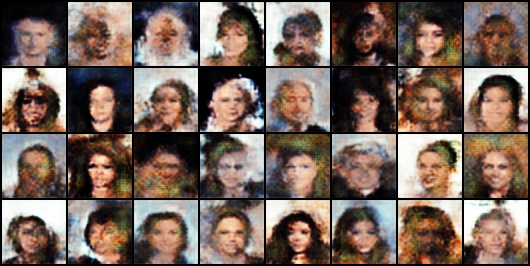

In [ ]:
fake = gen_pWDG(fixed_noise)
img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
img = torchvision.transforms.ToPILImage()(img_grid_fake)
# img.show()
img

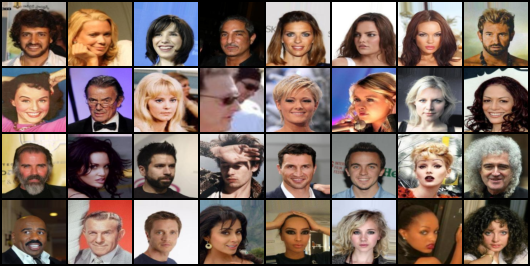

In [ ]:
img_grid_fake = torchvision.utils.make_grid(real[:32], normalize=True)
img = torchvision.transforms.ToPILImage()(img_grid_fake)
# img.show()
img

# **Implementation of Conditional GAN**

In [ ]:
 class cDGDiscriminator(nn.Module):
  def __init__(self, channels_img,features_d,num_classes,img_size):
    super(cDGDiscriminator, self).__init__()
    self.img_size = img_size
    # input: N x channels_img x 64 x64
    self.disc = nn.Sequential(
        nn.Conv2d(channels_img+1, features_d, kernel_size=4, stride=2, padding=1
        ), #32x32
        nn.LeakyReLU(0.2),
        self._block(features_d, features_d*2,4,2,1),#16x16
        self._block(features_d*2, features_d*4,4,2,1),#8x8
        self._block(features_d*4, features_d*8,4,2,1),#4x4
        nn.Conv2d(features_d*8, 1, kernel_size=4, stride=2, padding=0),#1x1
    )
    self.embed = nn.Embedding(num_classes,img_size*img_size)
  def _block(self,in_channel,out_channel,kernel_size,stride,padding):
    return nn.Sequential(
        nn.Conv2d(
            in_channel,
            out_channel,
            kernel_size,
            stride,
            padding,
            bias=False
        ),
        nn.InstanceNorm2d(out_channel,affine=True),#layerNorm <-> InstanceNorm
        nn.LeakyReLU(0.2)
    )

  def forward(self, x,label):
    embedding = self.embed(label).view(label.shape[0],1,self.img_size,self.img_size)
    x = torch.cat([x,embedding],dim=1)#  N x C x img_size (H) x img_size(W)
    return self.disc(x)


In [ ]:
class cDGGenerator(nn.Module):
  def __init__(self, z_dim,channels_img,features_g,num_classes,img_size,embed_size) -> None:
    super(cDGGenerator,self).__init__()
    self.img_size = img_size
    self.net = nn.Sequential(
        self._block(z_dim+embed_size,features_g*16,4,1,0),#4x4
        self._block(features_g*16,features_g*8,4,2,1),#8x8
        self._block(features_g*8,features_g*4,4,2,1),#16x16
        self._block(features_g*4,features_g*2,4,2,1),#32x32
        nn.ConvTranspose2d(
            features_g*2,channels_img,kernel_size=4,stride=2,padding=1
        ),
        nn.Tanh(),
    )
    self.embed = nn.Embedding(num_classes,embed_size)
  def _block(self,in_channel,out_channel,kernel_size,stride,padding):
    return nn.Sequential(
        nn.ConvTranspose2d(
            in_channel,
            out_channel,
            kernel_size,
            stride,
            padding,
            bias=False
        ),
        nn.BatchNorm2d(out_channel),
        nn.ReLU()
    )
  def forward(self,x,labels):
    # latent vector z: N x noise_dim x 1 x 1
    embedding = self.embed(labels).unsqueeze(2).unsqueeze(3)
    x = torch.cat([x,embedding],dim=1)
    return self.net(x)

def init_weight(model):
  for m in model.modules():
    if isinstance(m,(nn.Conv2d,nn.ConvTranspose2d,nn.BatchNorm2d)):
      nn.init.normal_(m.weight.data,0.0,0.02)


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
lr = 0.0001
z_dim = 100
batch_size = 64
channels_img = 1
features_d = 64
features_g = 64
image_size = 64
num_epochs = 5
lamda_gp =10
CRITIC_ITERATION=5
num_classes =10
gen_embeddings =100

In [ ]:
import torchvision.transforms as transforms
transforms = transforms.Compose(
    [transforms.Resize(image_size),transforms.ToTensor(), transforms.Normalize([0.5 for _ in range(channels_img)],[0.5 for _ in range(channels_img)])]
)

In [ ]:
dataset = datasets.MNIST(root="dataset/", transform=transforms, download=True)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 9912422/9912422 [00:11<00:00, 893405.50it/s] 


Extracting dataset/MNIST/raw/train-images-idx3-ubyte.gz to dataset/MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 28881/28881 [00:00<00:00, 131917.87it/s]


Extracting dataset/MNIST/raw/train-labels-idx1-ubyte.gz to dataset/MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 1648877/1648877 [00:01<00:00, 1111422.93it/s]


Extracting dataset/MNIST/raw/t10k-images-idx3-ubyte.gz to dataset/MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 4542/4542 [00:00<00:00, 3834647.50it/s]

Extracting dataset/MNIST/raw/t10k-labels-idx1-ubyte.gz to dataset/MNIST/raw



In [ ]:
gen_cWDG = cDGGenerator(z_dim,channels_img,features_g,num_classes,image_size,gen_embeddings).to(device)
critic_cWDG = cDGDiscriminator(channels_img,features_d,num_classes,image_size).to(device)
init_weight(gen_cWDG)
init_weight(critic_cWDG)

In [ ]:
opt_cwgen_dg = optim.Adam(gen_cWDG.parameters(),lr=lr,betas=(0.0,0.9))
opt_cwcritic_dg = optim.Adam(critic_cWDG.parameters(),lr=lr,betas=(0.0,0.9))
fixed_noise = torch.randn(batch_size,z_dim,1,1).to(device)
writer_real = SummaryWriter(f"runs/CWDG_MNIST/real")
writer_fake = SummaryWriter(f"runs/CWDG_MNIST/fake")
step = 0

In [ ]:
def gradient_penalty(critic,labels,real,fake,device='cpu'):
  batch_size,C,H,W = real.shape
  epsilon = torch.rand((batch_size,1,1,1)).repeat(1,C,H,W).to(device)
  interpolated_images = real*epsilon + fake*(1-epsilon)
  mixed_scores = critic(interpolated_images,labels)
  gradient = torch.autograd.grad(
      inputs=interpolated_images,
      outputs=mixed_scores,
      grad_outputs=torch.ones_like(mixed_scores),
      create_graph=True,
      retain_graph=True)[0]
  gradient = gradient.view(gradient.shape[0],-1)
  gradient_norm = gradient.norm(2,dim=1)
  gradient_penalty = torch.mean((gradient_norm-1)**2)
  return gradient_penalty

In [ ]:
gen_cWDG.train()
critic_cWDG.train()

for epoch in tqdm(range(num_epochs)):
  for batch_idx, (real, labels) in enumerate(loader):
    real = real.to(device)
    labels = labels.to(device)

    for _ in range(CRITIC_ITERATION):
      noise = torch.randn((batch_size,z_dim,1,1)).to(device)
      fake = gen_cWDG(noise,labels)
      # Train Generator: max log(D(G(z)))
      # Train Discriminator max log(D(x))+ log(1-D(G(z)))
      critic_real = critic_cWDG(real,labels).reshape(-1)
      critic_fake = critic_cWDG(fake,labels).reshape(-1)
      gp = gradient_penalty(critic_cWDG,labels,real,fake,device=device)
      loss_critic = (-(torch.mean(critic_real) - torch.mean(critic_fake))) + lamda_gp*gp
      critic_cWDG.zero_grad()
      loss_critic.backward(retain_graph=True)
      opt_cwcritic_dg.step()

    # train generator  min -E[critic(gen_fake)]
    output = critic_cWDG(fake,labels).reshape(-1)
    loss_gen = -(torch.mean(output))
    gen_cWDG.zero_grad()
    loss_gen.backward()
    opt_cwgen_dg.step()

    if batch_idx % 100 == 0:
      print(
          f"Epoch [{epoch}/{num_epochs}]\tBatch {batch_idx}/{len(loader)}\tLoss D: {loss_critic:.4f}\tLoss G: {loss_gen:.4f}"
      )
      with torch.no_grad():
        fake = gen_cWDG(noise,labels)
        img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
        img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
        writer_fake.add_image(
            "Mnist Fake Images", img_grid_fake, global_step=step
        )
        writer_real.add_image(
            "Mnist Real Images", img_grid_real, global_step=step
        )
      step += 1

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch [0/5]	Batch 0/938	Loss D: -12.0082	Loss G: 7.8953
Epoch [0/5]	Batch 100/938	Loss D: -87.5757	Loss G: 93.1691
Epoch [0/5]	Batch 200/938	Loss D: -63.2359	Loss G: 81.3215
Epoch [0/5]	Batch 300/938	Loss D: -41.3539	Loss G: 79.3420
Epoch [0/5]	Batch 400/938	Loss D: -26.1460	Loss G: 85.2911
Epoch [0/5]	Batch 500/938	Loss D: -17.2949	Loss G: 91.1441
Epoch [0/5]	Batch 600/938	Loss D: -15.5397	Loss G: 93.5440
Epoch [0/5]	Batch 700/938	Loss D: -10.9479	Loss G: 83.4623
Epoch [0/5]	Batch 800/938	Loss D: -12.6451	Loss G: 85.7829
Epoch [0/5]	Batch 900/938	Loss D: -9.4801	Loss G: 89.7143


  0%|          | 0/5 [16:30<?, ?it/s]


RuntimeError: Sizes of tensors must match except in dimension 1. Expected size 64 but got size 32 for tensor number 1 in the list.

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=runs/CWDG_MNIST

<IPython.core.display.Javascript object>

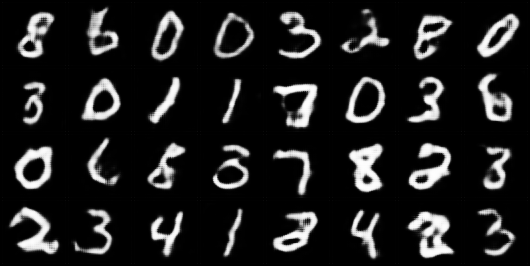

In [ ]:
fake = gen_cWDG(noise,labels)
img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
img = torchvision.transforms.ToPILImage()(img_grid_fake)
# img.show()
img

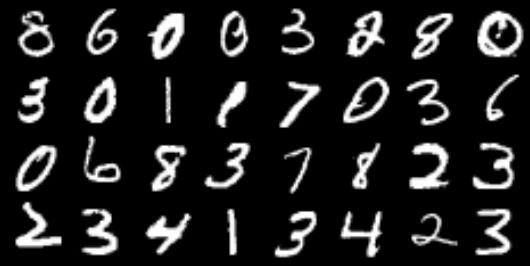

In [ ]:
img_grid_fake = torchvision.utils.make_grid(real[:32], normalize=True)
img = torchvision.transforms.ToPILImage()(img_grid_fake)
# img.show()
img